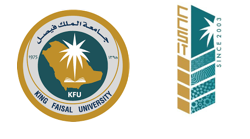

<h1><center>
King Faisal University <br>
College of Computer Sciences and Information Technology <br>
CS323: Digital Image Processing – Practical Class 
</h1>


<strong>
<center>[0921 - 323]: [Digital Image Processing]
<br><br>
<center>Section: [Male/Female]
<br><br><br><br>

<center>Lab [05]: [Edge Detection]
<br><br><br><br>

<center> Date: []
<center> Time: []
<br><br>


<center> Instructor: []
</strong>

# Introduction

In the process of image collection and transmission the image may be blurred and noisy due to some external factors that may affect image processing and recognition. In order to reduce the impact of such adverse effects, we need to use image sharpening methods to make image clearer. Image edge detection can be used to enhance the high-frequency part of the original image, sharpen and highlights the edge details of an image, improve the contrast of the image and make blurred images clearer.

Edge detection is an image-processing technique, which is used to identify the boundaries (edges) of objects, or regions within an image. Edges are among the most important features associated with images that are used in Computer vision processing pipelines. Edge detection can eliminate the noise in an image, extract variables used to characterize the image that provides basis for image recognition . 

**Objectives: **
* Implement different types of Edge Detection Methods such as:
    - Prewitt, Sobel, Laplacian and Canny Operator.
* Apply Edge Detection Method(s) to enhance an image.

**Tools/Software Requirement:**
*	Anaconda Navigator

**Lab Activity Description:**

Part 1: Edge Detection Methods
1. Compute Derivatives using finite Differences.  
2. Perwitt Operator
3. Sobel Operator
4. Laplacian Operator
5. Canny Operator

Part 2: Lab Task.
*	Student solves programming questions using Python and OpenCV.


# Part 1: Edge Detection Methods

Edge detection involves detecting the change in pixel intensities along the boundaries of the image. We can define the edges in the image using image gradients.

## 1.1 Derivatives and gradients

We can compute the (partial) derivatives of a digital image using finite differences. The following program shows how to compute the partial derivatives of an image (which is a function f(x, y)), using finite differences, which can be implemented using convolution (fillter2D function) with the given kernels.

### A. Import Libraries

In [37]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

### B. Read Image and convert to Grayscale

In [38]:
# Read images 
img = cv2.imread('chess.png')
chess_img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
# Grayscale the image 
grayImage = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

### C. Compute Derivatives using finite differences

cv2.filter2D(src, ddepth, kernel)

* src: The source image on which to apply the fitler. It is a matrix that represents the image in pixel intensity values.<br>
* ddepth: It is the desirable depth of destination image. Value -1 represents that the resulting image will have same depth as the source image.<br>
* kernel: kernel is the filter matrix applied on the image.

cv2.addWeighted(absX,1,absY,1,0)
* src1*alpha + src2*beta + gamma;


In [39]:
#Compute finite differences
kernelx = np.array([[-1, 1]], dtype=int) #forward difference
kernely = np.array([[-1], [1]], dtype=int) #central difference

#uses the kernel to realize the convolution operation of the image for edge extraction
x = cv2.filter2D(grayImage, cv2.CV_16S, kernelx) 
y = cv2.filter2D(grayImage, cv2.CV_16S, kernely)

# computes absolute values and converts the result to 8-bit
absX = cv2.convertScaleAbs(x) 
absY = cv2.convertScaleAbs(y)
#Calculates the weighted sum of two arrays.
gradient = cv2.addWeighted(absX,1,absY,1,0)

### D. Display Result

(<Axes: title={'center': 'Kernel DY'}>, None)

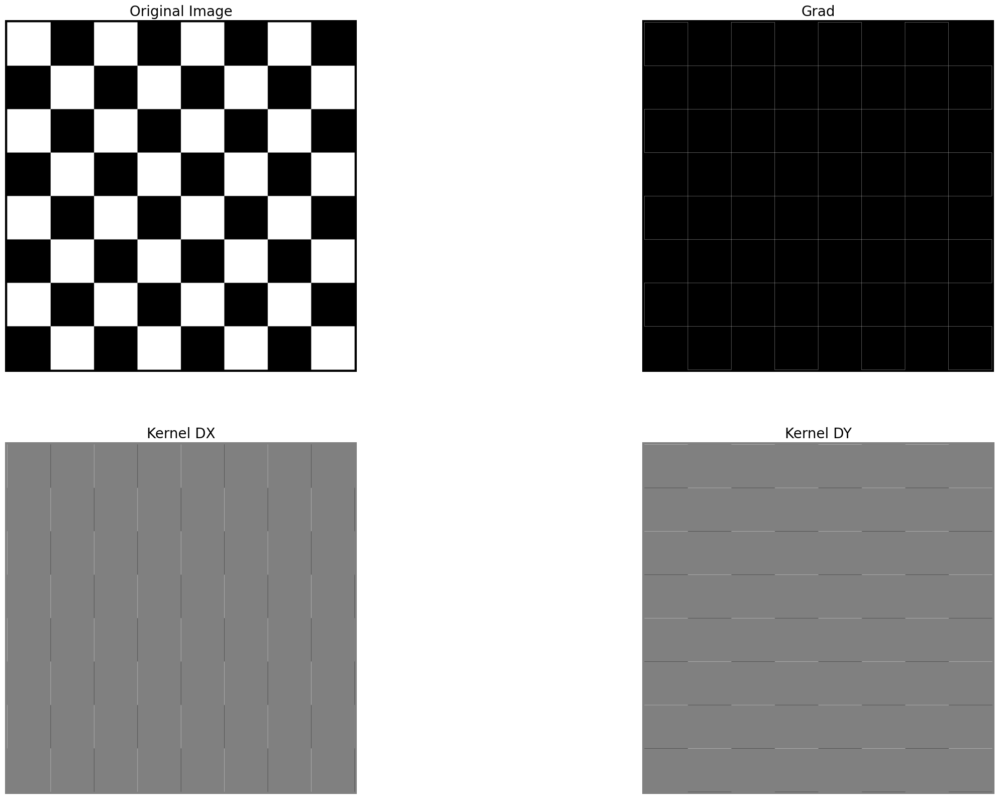

In [40]:
#sub plot function
def plot_image(image, title):
    plt.imshow(image, 'gray'), plt.title(title, size=20), plt.axis('off')
    
plt.figure(figsize=(30,20))
plt.subplot(221),plot_image(chess_img, 'Original Image')
plt.subplot(222),plot_image(gradient, 'Grad')
plt.subplot(223),plot_image(x, 'Kernel DX')
plt.subplot(224),plot_image(y, 'Kernel DY')

## 1.2 Prewitt operator
Prewitt It is a differential operator for image edge detection, its principle is to realize edge detection by using the difference generated by the gray value of pixels in a specific area . Prewitt operator used 3×3 template to calculate the pixel values in the region. 

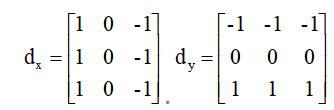

### A. Apply Perwitt Operator

In [41]:
#Prewitt operator 
kernelx = np.array([[1,1,1],[0,0,0],[-1,-1,-1]], dtype=int) #dx
kernely = np.array([[-1,0,1],[-1,0,1],[-1,0,1]], dtype=int) #dy

x = cv2.filter2D(grayImage, cv2.CV_16S, kernelx) 
y = cv2.filter2D(grayImage, cv2.CV_16S, kernely)

# turn uint8
absX = cv2.convertScaleAbs(x)
absY = cv2.convertScaleAbs(y)
Prewitt = cv2.addWeighted(absX,1,absY,1,0)

### D. Show result

The final operation results are shown below, on the left is the original image , on the right is Prewitt operator Image sharpens the extracted edge contour , The edge detection result of the rendering is better than that in the horizontal and vertical directions of the previous example .

(<Axes: title={'center': 'Kernel DY'}>, None)

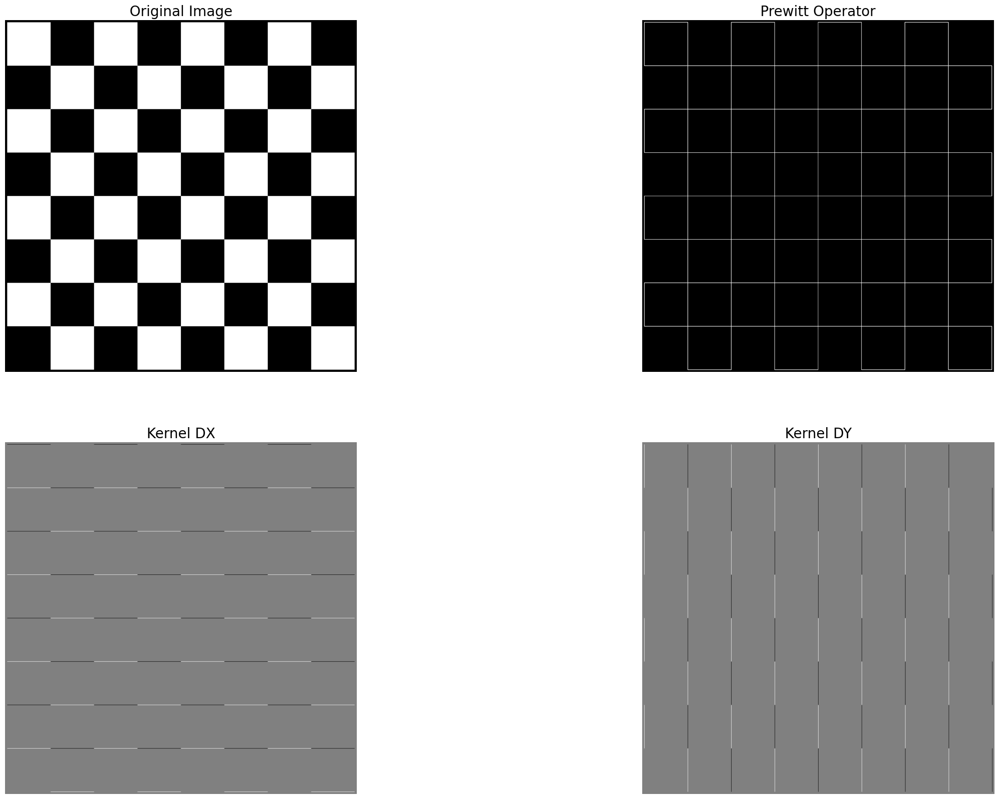

In [42]:
def plot_image(image, title):
    plt.imshow(image, 'gray'), plt.title(title, size=20), plt.axis('off')
    

plt.figure(figsize=(30,20))
plt.subplot(221),plot_image(chess_img, 'Original Image')
plt.subplot(222),plot_image(Prewitt, 'Prewitt Operator')
plt.subplot(223),plot_image(x, 'Kernel DX')
plt.subplot(224),plot_image(y, 'Kernel DY')

## 1.2 Sobel Edge Detector

Sobel Operator is a discrete differential operator for edge detection , it combines Gaussian smoothing with differential derivation. This operator is used to calculate the approximate value of image shading according to the brightness of the edge of the image more than a certain number of specific points in the region are marked as edges.

### A. Read Image and Convert to Grayscale

In [43]:
# Read images 
img = cv2.imread('lion.jpg')
lion_img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
# Grayscale the image 
grayImage = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

### B. Apply Sobel Operator

The following is the syntax for applying Sobel edge detection using OpenCV:

* Sobel(src, ddepth, dx, dy)

The parameter ddepth specifies the precision of the output image, while dx and dy specify the order of the derivative in each direction. For example:

 If dx=1 and dy=0, we compute the 1st derivative Sobel image in the x-direction.
 If dx=0 and dy=1, we compute the 1st derivative Sobel image in the y-direction.
 If both dx=1 and dy=1, we compute the 1st derivative Sobel image in both directions

In [44]:
#Sobel operator 
x = cv2.Sobel(grayImage, cv2.CV_16S, 1, 0) # Edge detection on X axis
y = cv2.Sobel(grayImage, cv2.CV_16S, 0, 1) # Edge detection on Y axis

absX = cv2.convertScaleAbs(x)
absY = cv2.convertScaleAbs(y)

Sobel = cv2.addWeighted(absX,1, absY,1, 0) #Combine both X and Y

### C. Display Result

(<Axes: title={'center': 'Iy'}>, None)

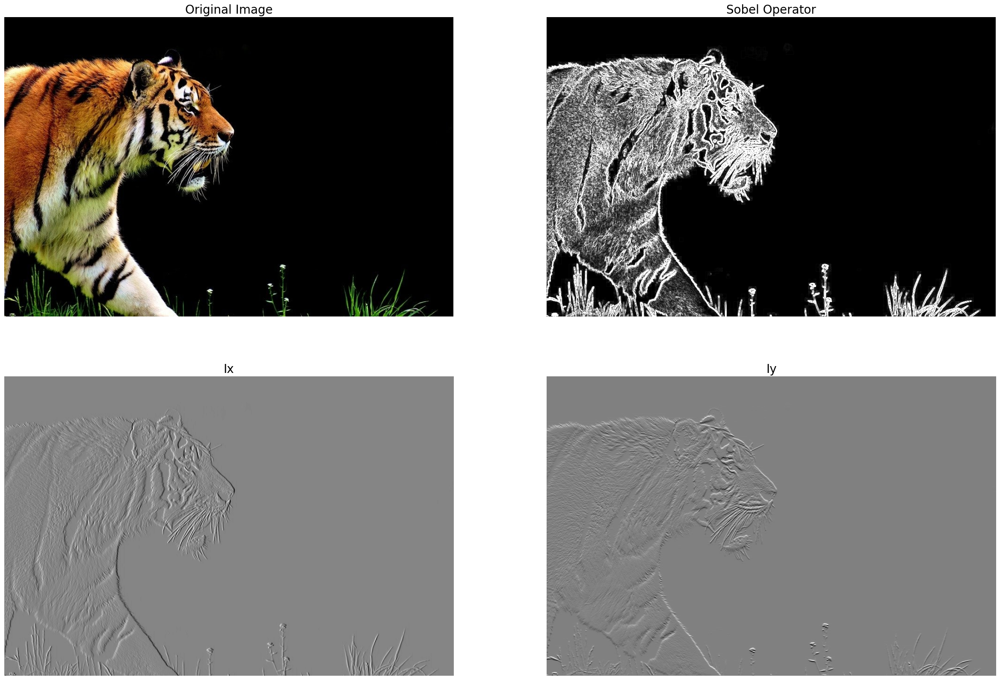

In [45]:
def plot_image(image, title):
    plt.imshow(image, 'gray'), plt.title(title, size=20), plt.axis('off')
    

plt.figure(figsize=(30,20))
plt.subplot(221),plot_image(lion_img, 'Original Image')
plt.subplot(222),plot_image(Sobel, 'Sobel Operator')
plt.subplot(223),plot_image(x, 'Ix')
plt.subplot(224),plot_image(y, 'Iy')

### D. Improving Result by applying Smoothing (GausianBlur)

(<Axes: title={'center': 'Iy'}>, None)

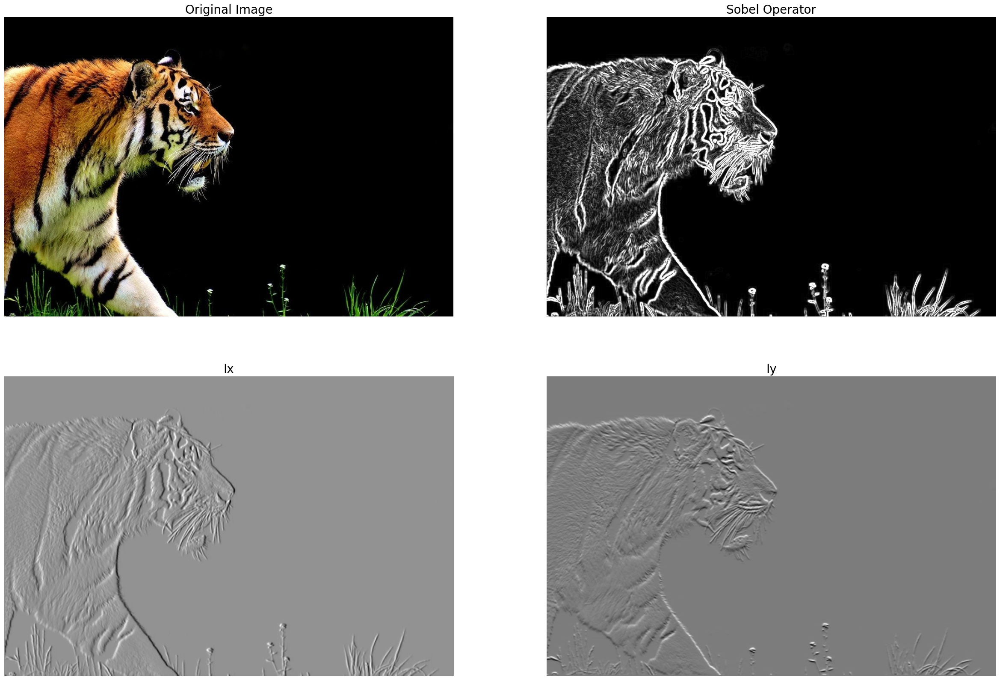

In [46]:
#apply GaussianBlur
gussian_blur = cv2.GaussianBlur(grayImage,(5,5),sigmaX=0, sigmaY=0)

#Sobel operator 
x = cv2.Sobel(gussian_blur, cv2.CV_16S, 1, 0) # Edge detection on X axis
y = cv2.Sobel(gussian_blur, cv2.CV_16S, 0, 1) # Edge detection on Y axis
absX = cv2.convertScaleAbs(x)
absY = cv2.convertScaleAbs(y)
SobelBlur = cv2.addWeighted(absX,1, absY,1, 0) #Combine both X and Y

#Plot
plt.figure(figsize=(30,20))
plt.subplot(221),plot_image(lion_img, 'Original Image')
plt.subplot(222),plot_image(SobelBlur, 'Sobel Operator')
plt.subplot(223),plot_image(x, 'Ix')
plt.subplot(224),plot_image(y, 'Iy')


## 1.3 Laplacian operator

Laplace （Laplacian） Operator is n A second-order differential operator, it is often used in the field of image enhancement and edge extraction . It calculates the pixels in the neighborhood by gray difference,  the basic process is: Judge the gray value of the center pixel of the image and the gray value of other pixels around it, If the gray level of the center pixel is higher ,the gray level of the center pixel is increased; On the contrary, reduce the gray level of the center pixel , so as to realize the image sharpening operation.

### A. Read Image and Convert to GrayScale

In [47]:
# Read images 
img = cv2.imread('lion.jpg')
lion_img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
# Grayscale the image 
grayImage = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

### B. Apply Lapacian Operator

In [48]:
# Laplace algorithm 
Laplacian = cv2.Laplacian(grayImage, cv2.CV_16S, ksize = 3)
Log = cv2.convertScaleAbs(Laplacian)

#apply GaussianBlur
gussian_blur = cv2.GaussianBlur(grayImage,(5,5),sigmaX=0, sigmaY=0)
LaplacianBlur = cv2.Laplacian(gussian_blur, cv2.CV_16S, ksize = 3)
LogBlur = cv2.convertScaleAbs(LaplacianBlur)


### C. Display Result

(<Axes: title={'center': 'Laplacian Operator with Gaussianblur'}>, None)

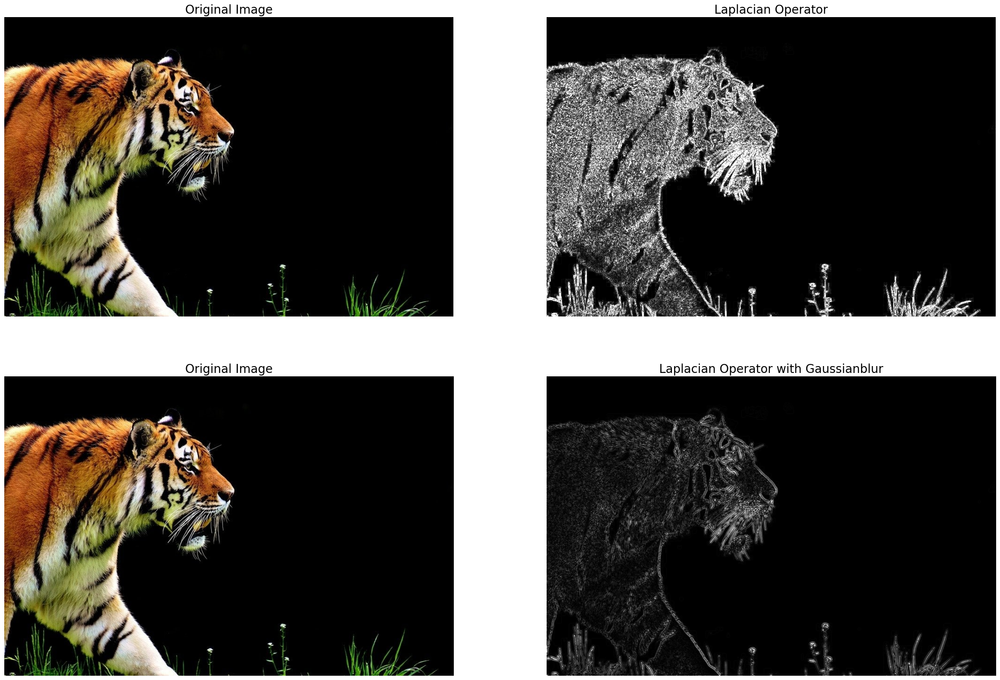

In [49]:
#Plot
plt.figure(figsize=(30,20))
plt.subplot(221),plot_image(lion_img, 'Original Image')
plt.subplot(222),plot_image(Log, 'Laplacian Operator')
plt.subplot(223),plot_image(lion_img, 'Original Image')
plt.subplot(224),plot_image(LogBlur, 'Laplacian Operator with Gaussianblur')

## 1.4 Canny Edge Detection

Canny Edge Detection is one of the most popular edge-detection methods in use today because it is so robust and flexible.The algorithm itself follows a three-stage process for extracting edges from an image in addition of image blurring, a necessary preprocessing step to reduce noise. This makes it a four-stage process, which includes:

1. Noise Reduction
2. Calculating Intensity Gradient of the Image
3. Suppression of False Edges
4. Hysteresis Thresholding

#### Step 1: Noise Reduction

(<Axes: title={'center': 'GaussianBlur Image'}>, None)

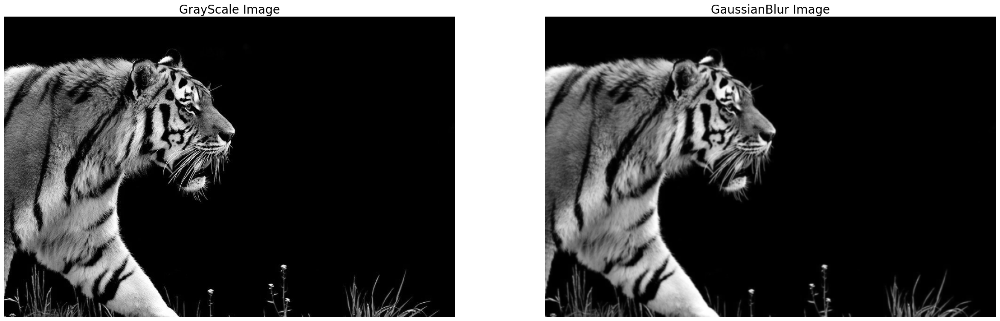

In [50]:
img = cv2.imread('lion.jpg')
lion_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
# Grayscale the image 
grayImage = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
# Gaussian filtering noise reduction 
gaussian = cv2.GaussianBlur(grayImage, (5,5), 0)

#plot
plt.figure(figsize=(30,20))
plt.subplot(121),plot_image(grayImage, 'GrayScale Image')
plt.subplot(122),plot_image(gaussian, 'GaussianBlur Image')

### Note: Following Steps are Applied using Canny() Function in Step 4.

#### Step 2: Calculating Intensity Gradient of the Image

Once the image has been smoothed (blurred), it is filtered with a Sobel kernel, both horizontally and vertically.

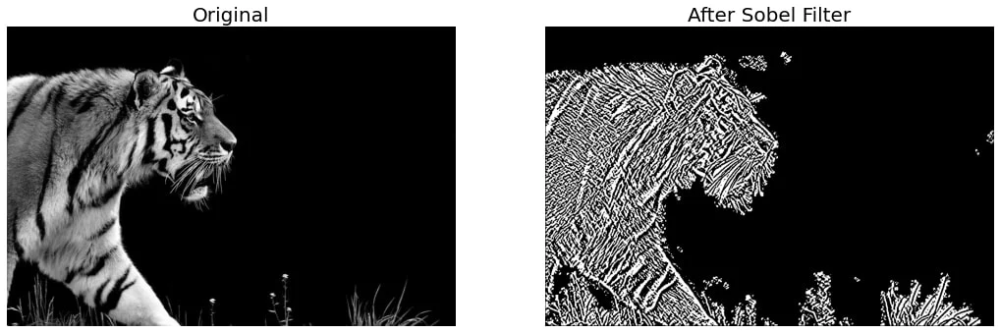

#### Step 3: Suppression of False Edges

After reducing noise and calculating the intensity gradient, the algorithm in this step uses a technique called non-maximum suppression of edges to filter out unwanted pixels (which may not actually constitute an edge). 
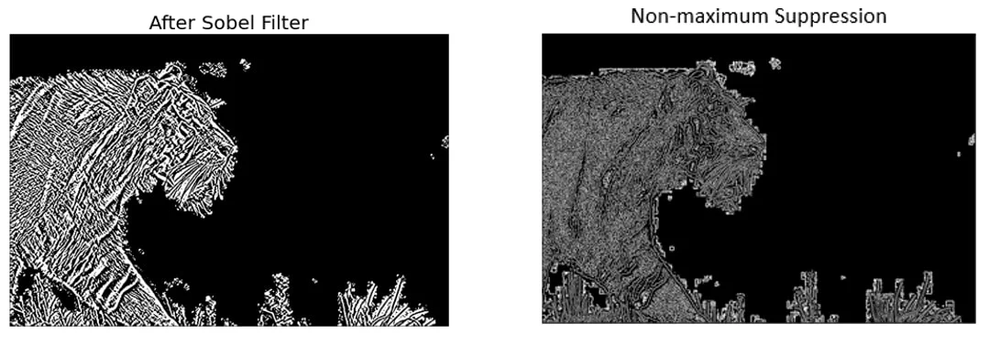

#### Step 4: Hysteresis Thresholding

In this final step of Canny Edge Detection, the gradient magnitudes are compared with two threshold values, one smaller than the other. 

* If the gradient magnitude value is higher than the larger threshold value, those pixels are associated with strong edges, and are included in the final edge map.
* If the gradient magnitude values are lower than the smaller threshold value, the pixels are suppressed, and excluded from the final edge map.
* All the other pixels, whose gradient magnitudes fall in between these two thresholds, are marked as ‘weak’ edges (i.e. they become candidates for being included in the final edge map). 
* If the ‘weak’ pixels are connected  to those associated with strong edges, then they too are included in the final edge map. 

### A. Applying Canny() Function

The following is the syntax for applying Canny edge detection using OpenCV:

* cv2.Canny(image, threshold1, threshold2,apertureSize, L2gradient)
    - image Represents the input image
    - threshold1 Represents the first hysteresis threshold
    - threshold2 Represents the second hysteresis threshold
    - apertureSize Show application Sobel The aperture size of the operator , The default value is 3
    - L2gradient Represents an identifier for calculating the gradient amplitude of the image , The default value is false

In the code example below, the  Canny() function implements the methodology described above. We just supply the two thresholds used by the Canny Edge Detection algorithm, and OpenCV handles all the implementation details. 

(<Axes: title={'center': 'Canny Operator'}>, None)

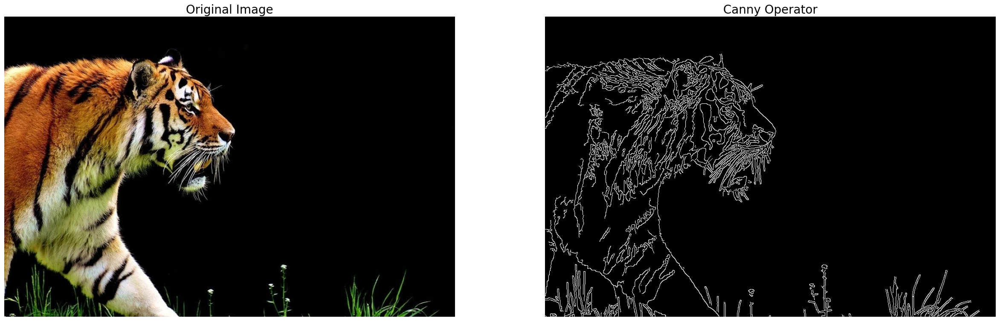

In [51]:
#Apply Canny
edges = cv2.Canny(gaussian, 50, 150, 3, L2gradient=True)

#plot
plt.figure(figsize=(30,20))
plt.subplot(121),plot_image(lion_img, 'Original Image')
plt.subplot(122),plot_image(edges, 'Canny Operator')

## 1.5 Putting All Together

(<Axes: title={'center': 'Canny Operator'}>, None)

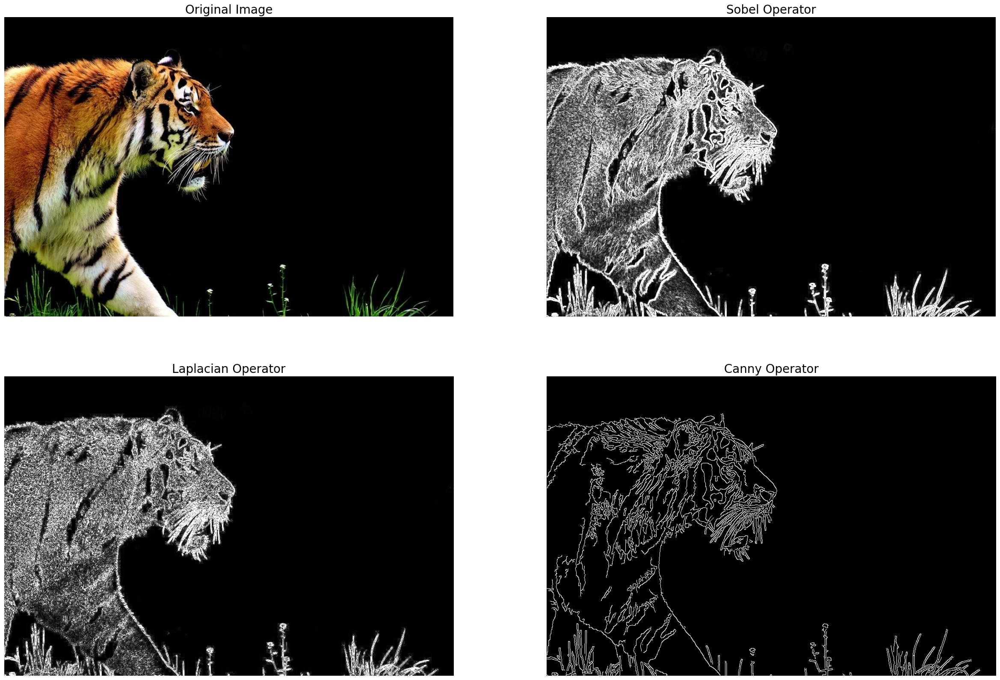

In [52]:
plt.figure(figsize=(30,20))
plt.subplot(221),plot_image(lion_img, 'Original Image')
plt.subplot(222),plot_image(Sobel, 'Sobel Operator')
plt.subplot(223),plot_image(Log, 'Laplacian Operator')
plt.subplot(224),plot_image(edges, 'Canny Operator')

# Part 2: Lab Task 

## Task 01
Write a program that will read the original image on the left then apply appropriate Image enhancement to obtain the new image in the right.

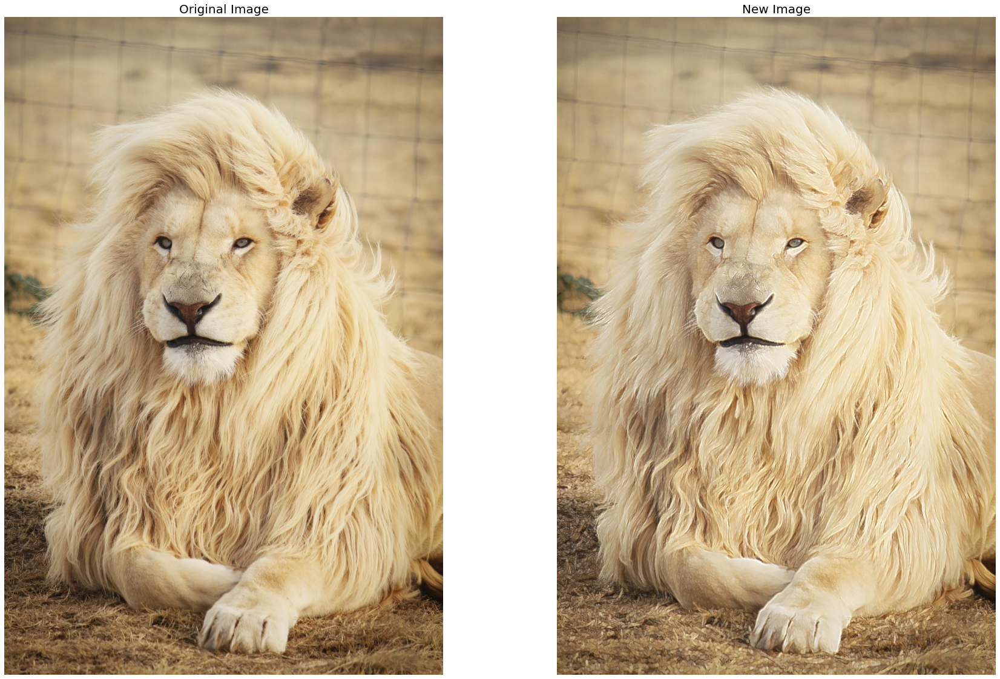

(<Axes: title={'center': 'Prewitt Operator'}>, None)

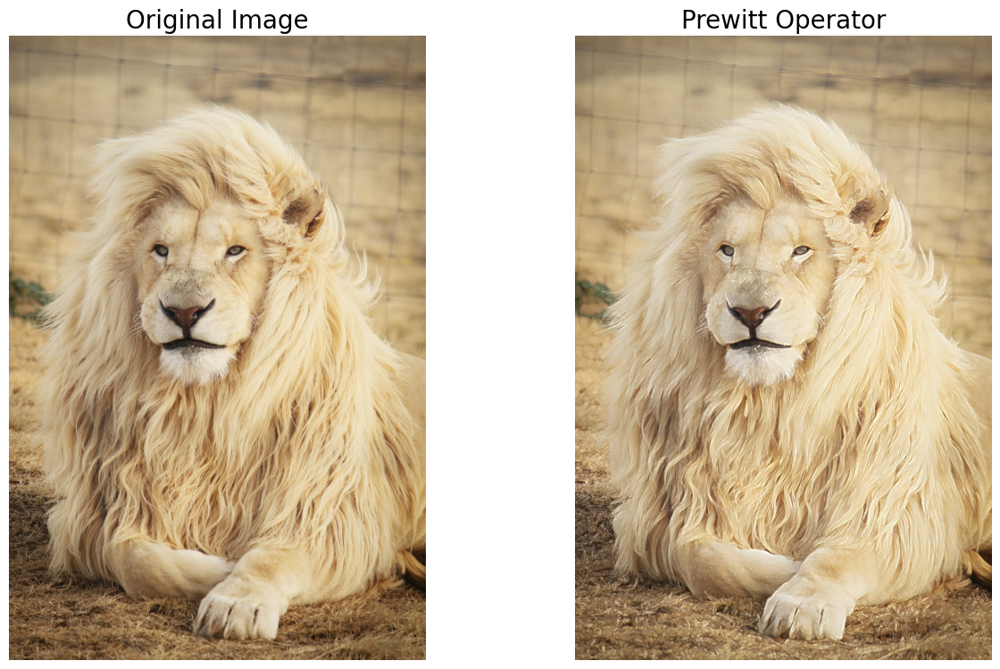

In [53]:
#write your code here
import cv2
import numpy as np
import matplotlib.pyplot as plt
import scipy.ndimage as ndimage
img = cv2.imread('Task01.jpeg')
lion_img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
#gussian_blur = cv2.GaussianBlur(grayImage,(1,1),sigmaX=0, sigmaY=0)
kernelx = np.array([[1,1,1],[0,0,0],[-1,-1,-1]], dtype=int) #dx
kernely = np.array([[-1,0,1],[-1,0,1],[-1,0,1]], dtype=int) #dy
# Applying the filter
gussian_blur = cv2.GaussianBlur(lion_img,(5,5),sigmaX=0, sigmaY=0)
x = cv2.filter2D(gussian_blur, cv2.CV_16S, kernelx) 
y = cv2.filter2D(gussian_blur, cv2.CV_16S, kernely)
absX = cv2.convertScaleAbs(x)
absY = cv2.convertScaleAbs(y)
Prewitt = cv2.addWeighted(absX,1,absY,1,0)
gradient = cv2.addWeighted(lion_img,1,Prewitt,0.4,0)
#Plot
plt.figure(figsize=(15,20))
plt.subplot(221),plot_image(lion_img, 'Original Image')
plt.subplot(222),plot_image(gradient, 'Prewitt Operator')

## Task 02
Turn yourself into a ghost Like Casper! 

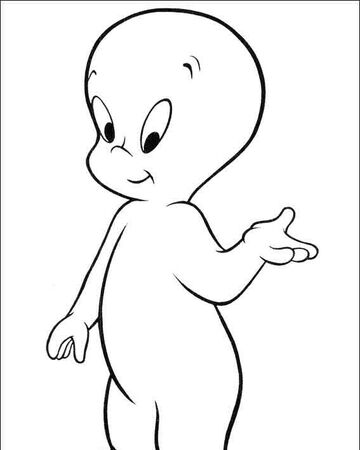

Take a selfie and transfer in into your computer or use the sample image below. Write a program that will turn this image into a ghost Like Casper the Friendly Ghost as shown in the output below.

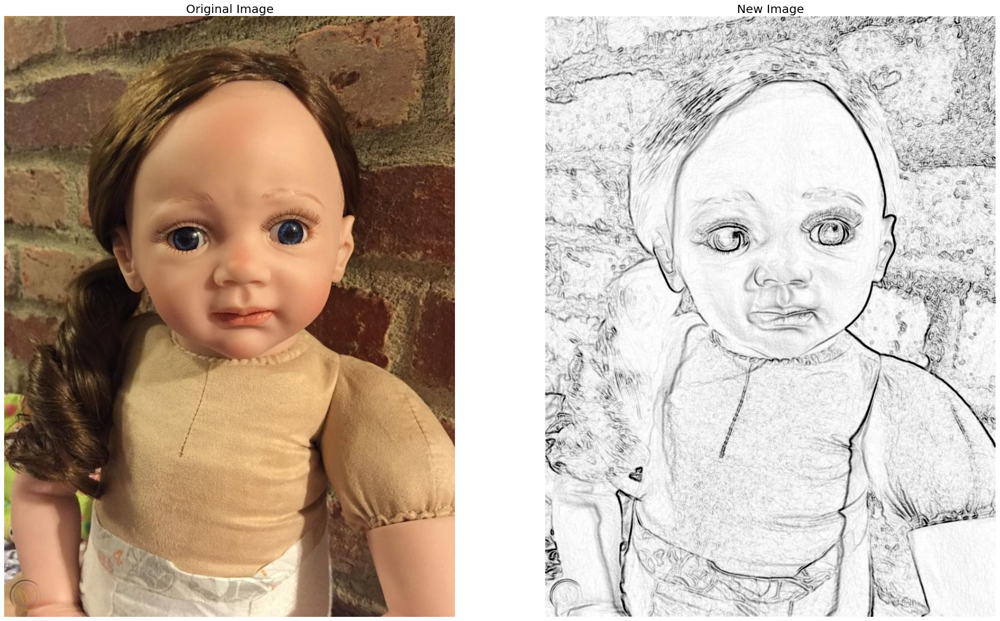

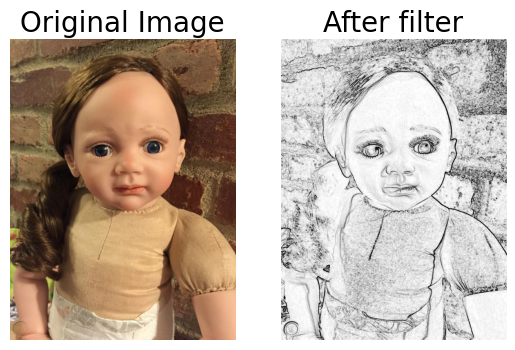

In [55]:
#Write your Code here
import cv2
from matplotlib import pyplot as plt

# Load the original image
image1 = cv2.imread('Task02.jpg')
cimg = cv2.cvtColor(image1,cv2.COLOR_BGR2RGB)
girlimg = cv2.cvtColor(image1,cv2.COLOR_BGR2GRAY)
kernelx = np.array([[1,1,1],[0,0,0],[-1,-1,-1]], dtype=int) #dx
kernely = np.array([[-1,0,1],[-1,0,1],[-1,0,1]], dtype=int) #dy

x = cv2.Sobel(girlimg, cv2.CV_16S, 1, 0) # Edge detection on X axis
y = cv2.Sobel(girlimg, cv2.CV_16S, 0, 1) # Edge detection on Y axis

absX = cv2.convertScaleAbs(x)
absY = cv2.convertScaleAbs(y)

Sobel = cv2.addWeighted(absX,1, absY,1, 0) #Combine both X and Y
plt.subplot(121),plot_image(cimg, 'Original Image')
plt.imshow(cimg)
plt.subplot(122),plot_image(Sobel, 'After filter')
plt.imshow(Sobel,cmap='binary')
plt.show()

## 